In [1]:
%run ~/Documents/Projects/scripts/init.ipy
os.chdir(os.getcwd().replace('/pipeline/notebooks', ''));

In [2]:
infiles = glob.glob('./s5-enrichment_results.dir/*')[:-1]
infiles

['./s5-enrichment_results.dir/AHF2697-control_vs_RL-enrichment.txt',
 './s5-enrichment_results.dir/AHF2617-control_vs_RL-enrichment.txt',
 './s5-enrichment_results.dir/Keloid_MW3-control_vs_RL-enrichment.txt',
 './s5-enrichment_results.dir/A375_melanoma-control_vs_RL-enrichment.txt',
 './s5-enrichment_results.dir/AG13145-control_vs_RL-enrichment.txt',
 './s5-enrichment_results.dir/AHF2796-control_vs_RL-enrichment.txt']

## Heatmap

In [29]:
results = []
for infile in infiles:
    enrichment_dataframe = pd.read_table(infile)
    cell_line = os.path.basename(infile).split('-')[0]
    enrichment_dataframe['cell_line'] = cell_line
    results.append(enrichment_dataframe)
result_dataframe = pd.concat(results)
result_dataframe.head()

,term_name,zscore,combined_score,FDR,pvalue,overlapping_genes,gene_set_library,log10P,direction,cell_line
0,ncRNA processing (GO:0034470),-1.930413,23.558970,0.005310,0.000005,"['NOP56', 'DDX49', 'SMAD3', 'RRP7BP', 'WDR3', ...",GO_Biological_Process_2018,5.300176,up,AHF2697
1,collagen biosynthetic process (GO:0032964),-3.090335,23.462672,0.152741,0.000504,"['COL1A1', 'COL5A1', 'P3H3']",GO_Biological_Process_2018,3.297283,up,AHF2697
2,rRNA metabolic process (GO:0016072),-1.944394,21.890652,0.007782,0.000013,"['NOP56', 'DDX49', 'RRP7BP', 'WDR3', 'RPS5', '...",GO_Biological_Process_2018,4.889436,up,AHF2697
3,regulation of cellular response to growth fact...,-2.840635,19.326544,0.213884,0.001110,"['FBN2', 'SFRP4', 'FGFR2', 'FBN1']",GO_Biological_Process_2018,2.954766,up,AHF2697
4,tRNA wobble base modification (GO:0002097),-3.065820,18.751857,0.278803,0.002206,"['CTU2', 'CTU1', 'KIAA1456']",GO_Biological_Process_2018,2.656329,up,AHF2697


In [30]:
plot_dataframe = result_dataframe.pivot_table(index='term_name', columns='cell_line', values='log10P', aggfunc=max)
plot_dataframe.head()

cell_line,A375_melanoma,AG13145,AHF2617,AHF2697,AHF2796,Keloid_MW3
term_name,,,,,,
'de novo' posttranslational protein folding (GO:0051084),0.264333,0.742003,0.742003,0.742003,0.742003,0.742003
1-acylglycerol-3-phosphate O-acyltransferase activity (GO:0003841),0.417943,NaN,0.417943,0.417943,NaN,NaN
1-phosphatidylinositol binding (GO:0005545),0.500215,0.500215,NaN,1.277095,NaN,0.500215
1-phosphatidylinositol-3-kinase activity (GO:0016303),0.520785,0.520785,0.520785,0.520785,0.172534,0.520785
1-phosphatidylinositol-3-kinase regulator activity (GO:0046935),NaN,NaN,NaN,0.789331,NaN,0.789331


In [272]:
description = plot_dataframe.T.describe().T#.sort_values('std', ascending=False)
description.head()

,count,mean,std,min,25%,50%,75%,max
term_name,,,,,,,,
'de novo' posttranslational protein folding (GO:0051084),6.0,0.662392,0.195008,0.264333,0.742003,0.742003,0.742003,0.742003
1-acylglycerol-3-phosphate O-acyltransferase activity (GO:0003841),3.0,0.417943,0.000000,0.417943,0.417943,0.417943,0.417943,0.417943
1-phosphatidylinositol binding (GO:0005545),4.0,0.694435,0.388440,0.500215,0.500215,0.500215,0.694435,1.277095
1-phosphatidylinositol-3-kinase activity (GO:0016303),6.0,0.462743,0.142173,0.172534,0.520785,0.520785,0.520785,0.520785
1-phosphatidylinositol-3-kinase regulator activity (GO:0046935),2.0,0.789331,0.000000,0.789331,0.789331,0.789331,0.789331,0.789331


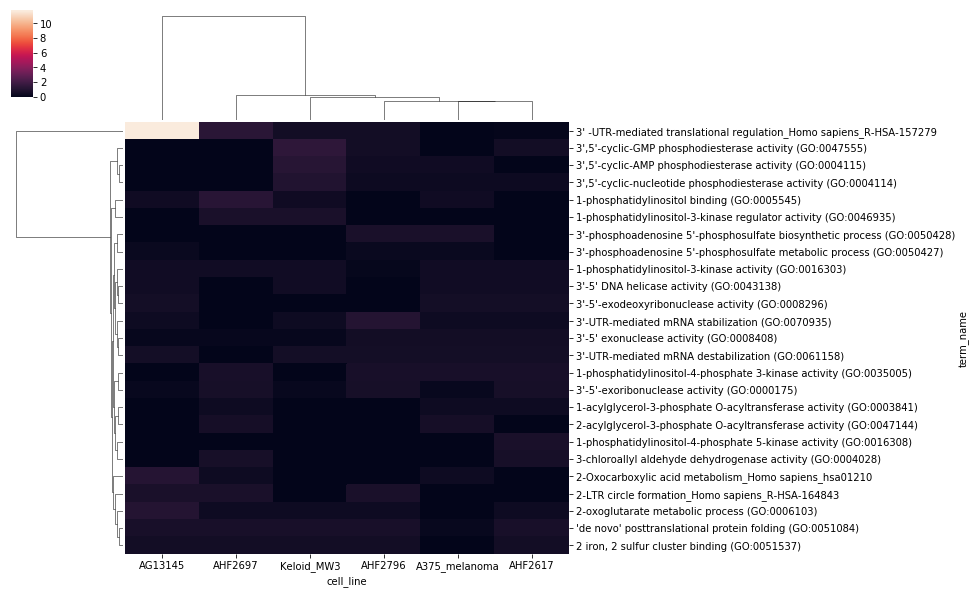

In [273]:
sns.clustermap(plot_dataframe.loc[description.index[:25]].fillna(0))

## Stacked Barplot

In [3]:
results = []
for infile in infiles:
    enrichment_dataframe = pd.read_table(infile)
    cell_line = os.path.basename(infile).split('-')[0]
    enrichment_dataframe['cell_line'] = cell_line
    terms = []
    for term_name in enrichment_dataframe['term_name']:
        for key, value in {'_Homo sapiens_': ' - human - ', '_Mus musculus_': ' - mouse -'}.items():
            if key in term_name:
                term_name = term_name.replace(key, value)
#                 term_name = term_name.split(key)[0]+' ({})'.format(value)
        terms.append(term_name.replace('_', ' '))
    enrichment_dataframe['term_name'] = terms
    results.append(enrichment_dataframe)
result_dataframe = pd.concat(results)
enrichment_dataframes = {x: result_dataframe[result_dataframe['direction'] == x] for x in ['up', 'down']}
enrichment_dataframes['down'].head()

,term_name,zscore,combined_score,FDR,pvalue,overlapping_genes,gene_set_library,log10P,direction,cell_line
7509,ncRNA processing (GO:0034470),-1.930413,23.558970,0.005310,0.000005,"['NOP56', 'DDX49', 'SMAD3', 'RRP7BP', 'WDR3', ...",GO_Biological_Process_2018,5.300176,down,AHF2697
7510,collagen biosynthetic process (GO:0032964),-3.090335,23.462672,0.152741,0.000504,"['COL1A1', 'COL5A1', 'P3H3']",GO_Biological_Process_2018,3.297283,down,AHF2697
7511,rRNA metabolic process (GO:0016072),-1.944394,21.890652,0.007782,0.000013,"['NOP56', 'DDX49', 'RRP7BP', 'WDR3', 'RPS5', '...",GO_Biological_Process_2018,4.889436,down,AHF2697
7512,regulation of cellular response to growth fact...,-2.840635,19.326544,0.213884,0.001110,"['FBN2', 'SFRP4', 'FGFR2', 'FBN1']",GO_Biological_Process_2018,2.954766,down,AHF2697
7513,tRNA wobble base modification (GO:0002097),-3.065820,18.751857,0.278803,0.002206,"['CTU2', 'CTU1', 'KIAA1456']",GO_Biological_Process_2018,2.656329,down,AHF2697


In [13]:
%%R
stacked_barplot <- function(stacked_plot_dataframe, terms, direction, library) {
    
stacked_plot_dataframe$term_name <- factor(stacked_plot_dataframe$term_name, levels=rev(terms))
gp <- ggplot(stacked_plot_dataframe, aes(x=term_name, y=log10P, fill=cell_line)) +
    geom_bar(stat='identity') +
    #facet_wrap(~, scales='free') +
    coord_flip() +
    #scale_fill_manual(values=c('', '')) +
    #scale_fill_gradient2(low='black', mid='yellow', high='red', trans='log10', midpoint='1') +
    #scale_color_gradient2(low='black', mid='yellow', high='red', trans='log10', midpoint='1') +
    #scale_x_log10() +
    #scale_y_log10() +
    #scale_x_continuous(lim=c(min(ticks), max(ticks)), breaks=ticks, labels=ticks, trans='log10') +
    #scale_y_continuous(lim=c(min(ticks), max(ticks)), breaks=ticks, labels=ticks, trans='log10') +
    #ggtitle('') +
    #geom_abline(intercept=0, slope=1) +
    #xlab('') +
    #ylab('') +
    labs(title = paste0('Top Shared Enrichment Results - ', direction, 'regulated genes\n(', library,')'), y = 'Cumulative -log10P', x = '', color = '', fill='Cell line') +
    #guides(fill=FALSE) +
    theme_classic() +
    theme(axis.title.x = element_text(vjust=-1), axis.title.y = element_text(vjust=2.5), axis.line = element_line(colour = 'black', size=0.2), strip.background = element_rect(color='black', fill='white', size=0))
print(gp)
ggsave(paste0('pipeline/plots/',library,'-',direction,'.png'), plot=gp)
}


/Users/denis/anaconda3/lib/python3.6/site-packages/rpy2/robjects/pandas2ri.py:191: FutureWarning:

from_items is deprecated. Please use DataFrame.from_dict(dict(items), ...) instead. DataFrame.from_dict(OrderedDict(items)) may be used to preserve the key order.

/Users/denis/anaconda3/lib/python3.6/site-packages/rpy2/rinterface/__init__.py:146: RRuntimeWarning:

Saving 10 x 5 in image




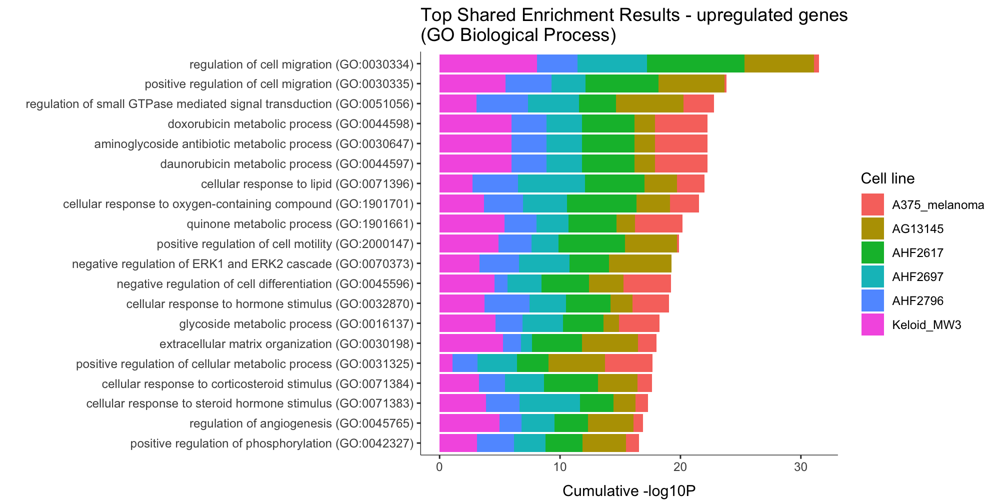

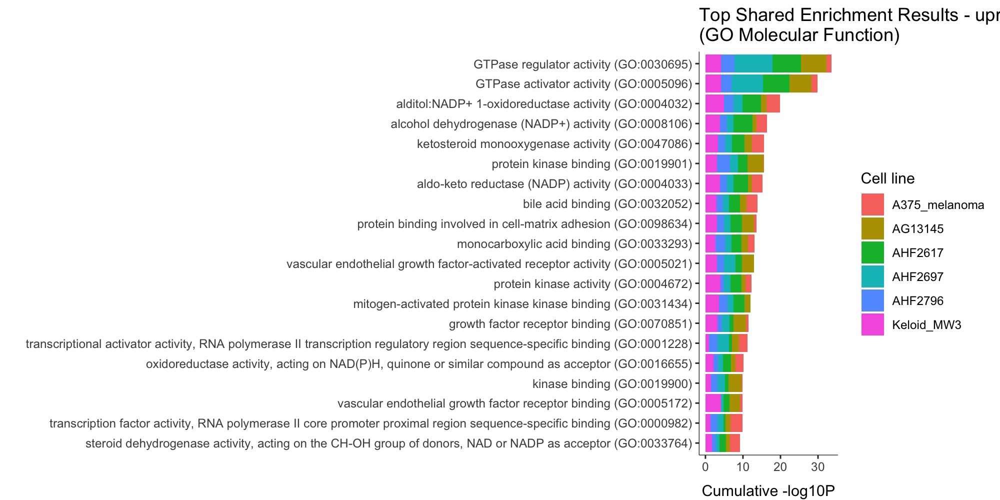

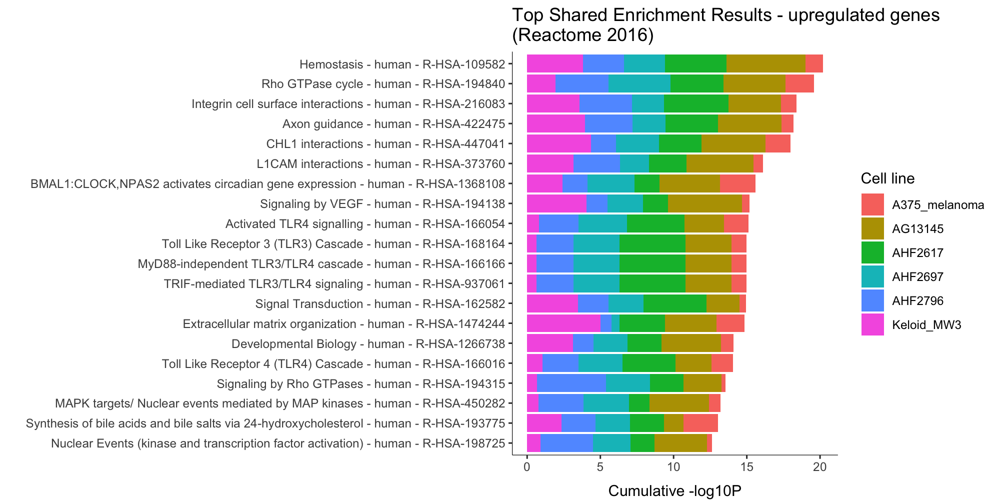

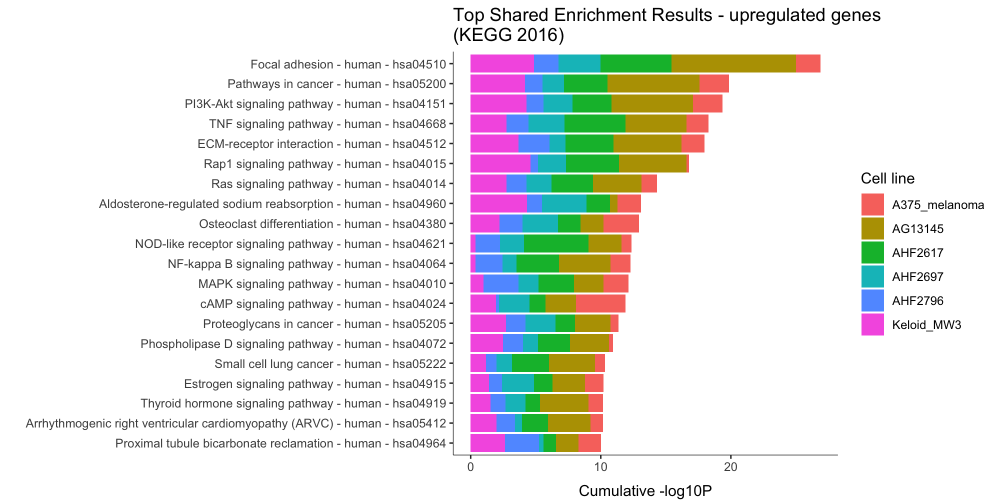

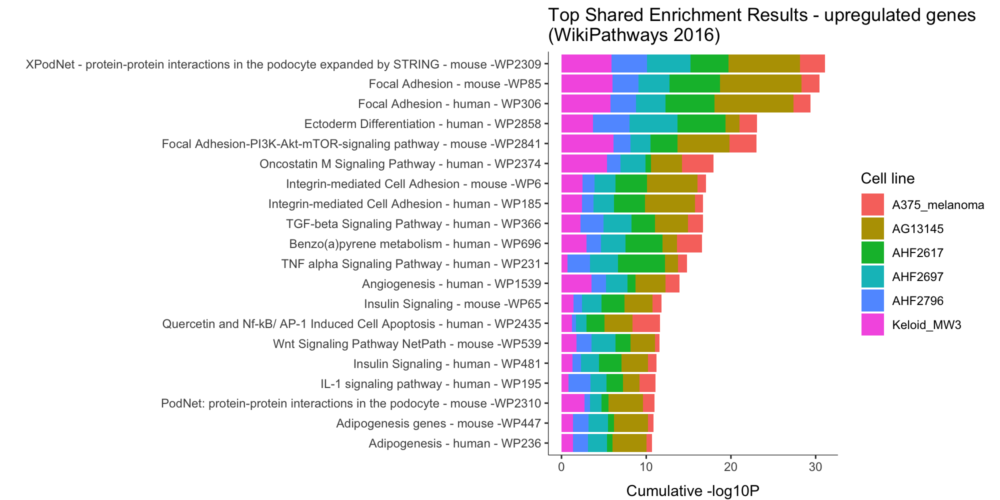

...

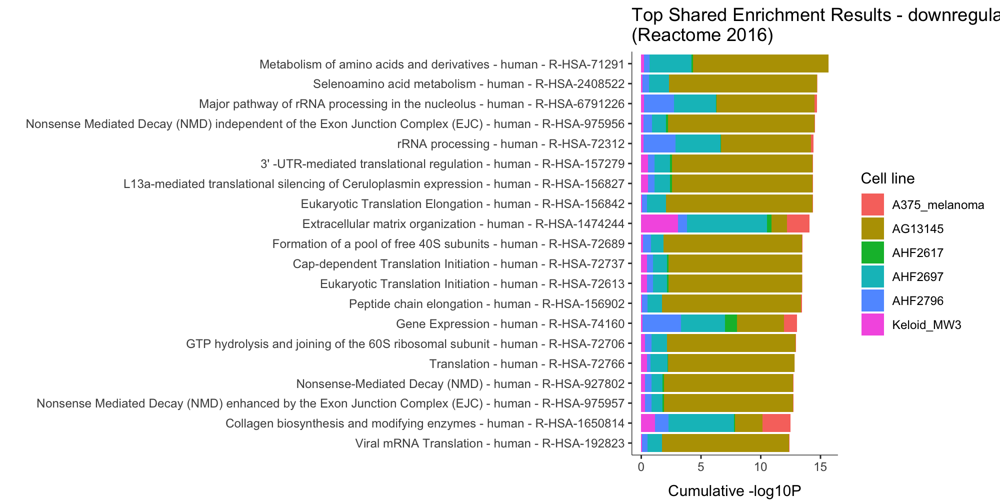

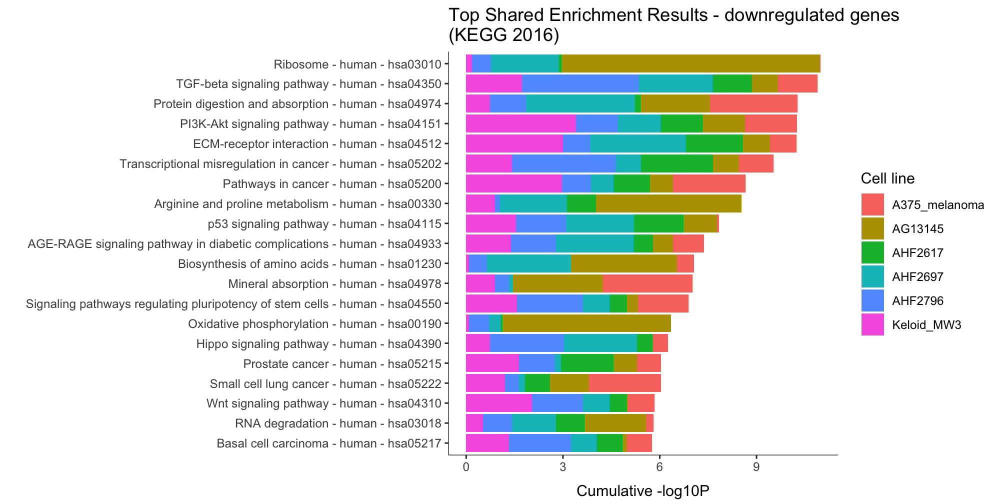

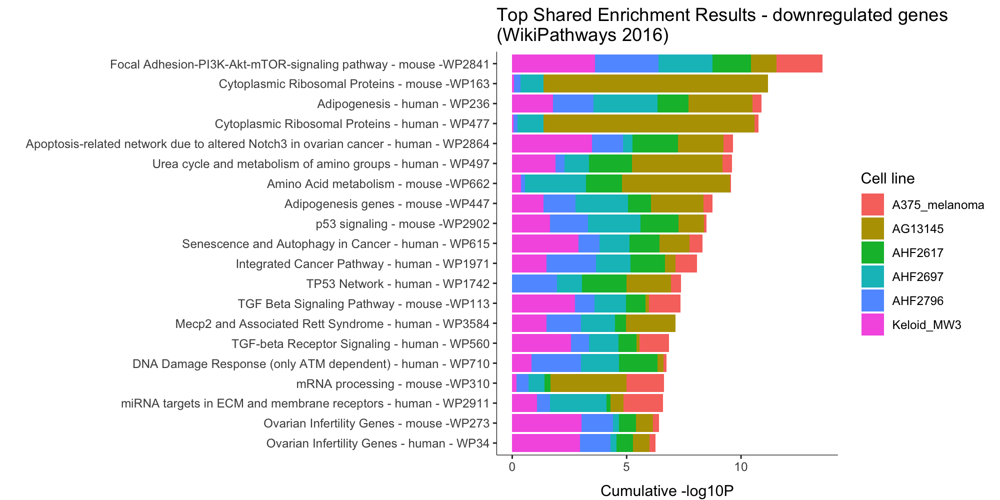

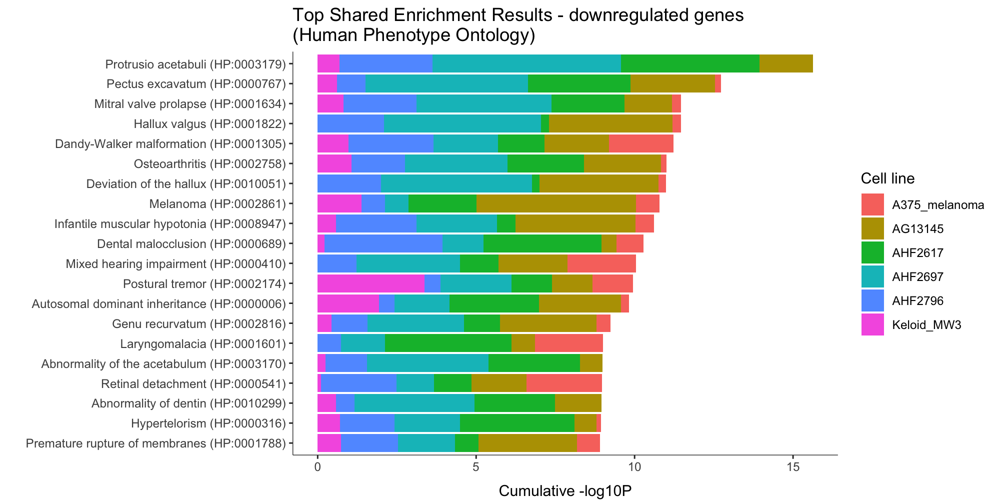

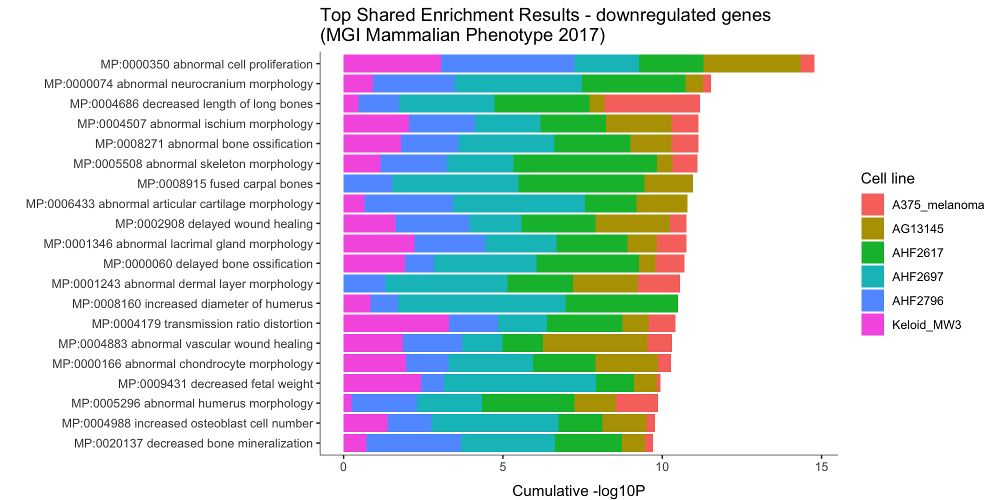

In [14]:
for direction, enrichment_dataframe_subset in enrichment_dataframes.items():
    for library in enrichment_dataframe_subset['gene_set_library'].unique():
        enrichment_dataframe_subset_subset = enrichment_dataframe_subset[enrichment_dataframe_subset['gene_set_library'] == library]
        pivot_dataframe = enrichment_dataframe_subset_subset.pivot(index='term_name', columns='cell_line', values='log10P')
        terms = pivot_dataframe.sum(axis=1).sort_values(ascending=False).index[:20]
        stacked_plot_dataframe = enrichment_dataframe_subset_subset.set_index('term_name', drop=False).loc[terms]
        library = library.replace('_', ' ').replace(' 2018', '')
        %R -i stacked_plot_dataframe,terms,direction,library -h 1000 -w 2000 -r 200 stacked_barplot(stacked_plot_dataframe, terms, direction, library) 

## Barplots

In [6]:
enrichment_results = {os.path.basename(infile).split('-')[0]: pd.read_table(infile).sort_values(['direction', 'pvalue']) for infile in infiles}

In [7]:
%%R
enrichment_barplot <- function(enrichment_dataframe, direction, cell_line='cells', nr_terms=15) {
    plot_dataframe <- enrichment_dataframe[enrichment_dataframe$direction == direction,][1:nr_terms,]
    plot_dataframe<- plot_dataframe[seq(dim(plot_dataframe)[1],1),]
    par(mgp=c(3,1,0))
    bar <- barplot(plot_dataframe$log10P,
        horiz=TRUE,
        col = if (direction == 'up') {1; 'red'} else 'lightblue',
        xlab = '-log10P'
    )
    text(0, bar, plot_dataframe$term_name, pos=4)
    title(paste0('Terms ', direction, 'regulated in RL-treated ', cell_line), line=0.3)
    title(ylab="Top Enriched Terms", mgp=c(1,1,0))
}

/Users/denis/anaconda3/lib/python3.6/site-packages/rpy2/robjects/pandas2ri.py:191: FutureWarning:

from_items is deprecated. Please use DataFrame.from_dict(dict(items), ...) instead. DataFrame.from_dict(OrderedDict(items)) may be used to preserve the key order.



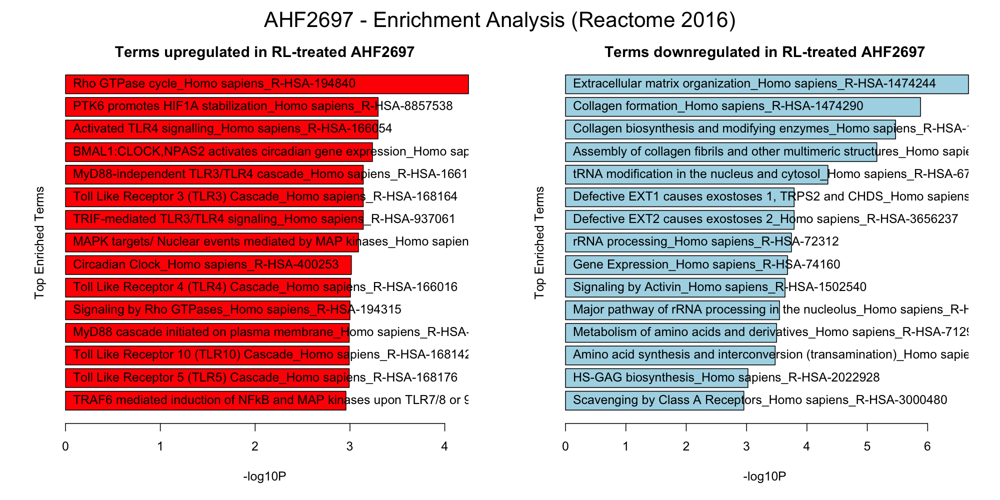

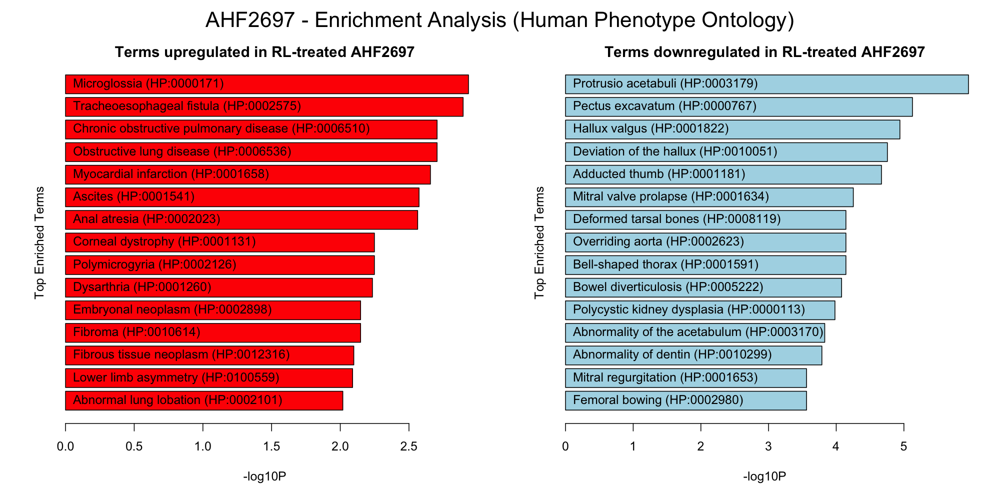

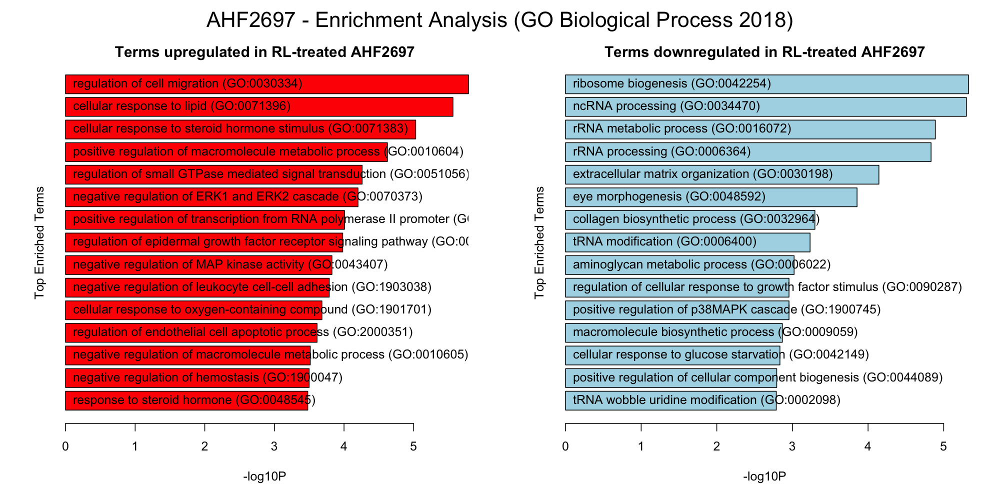

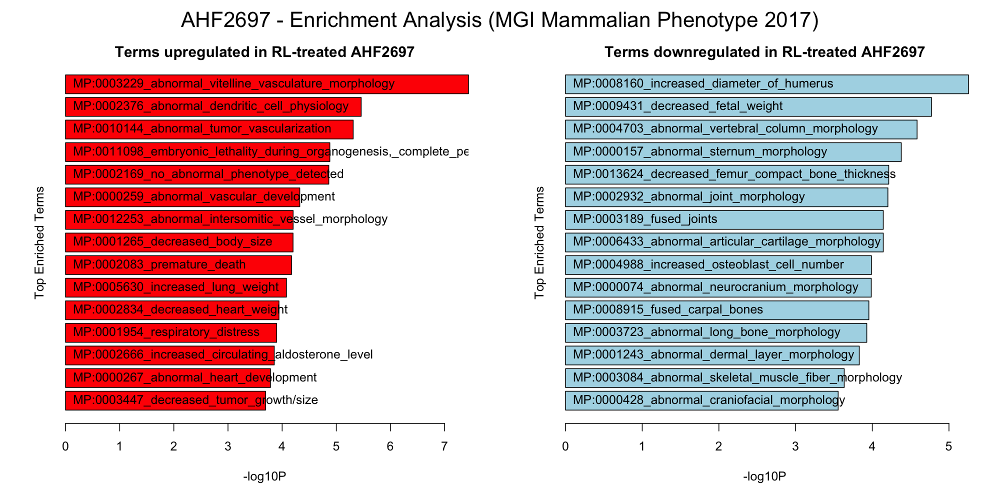

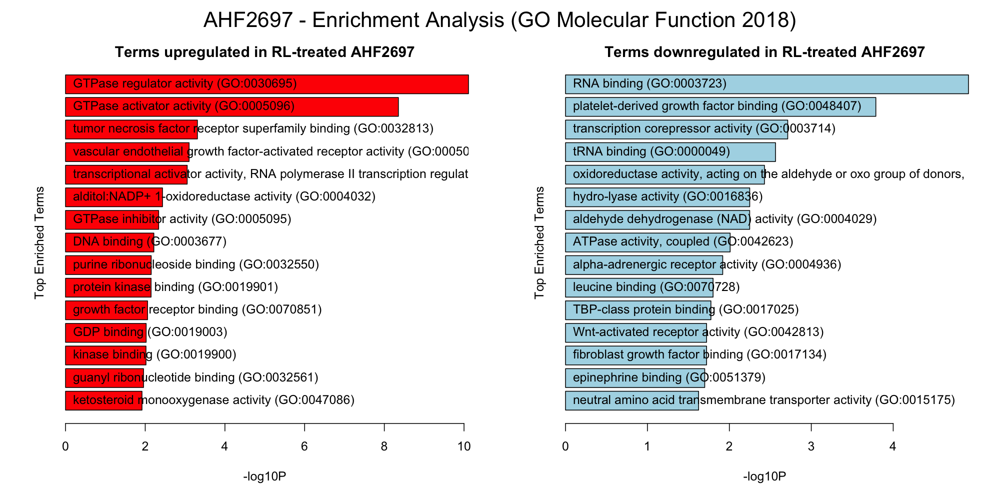

...

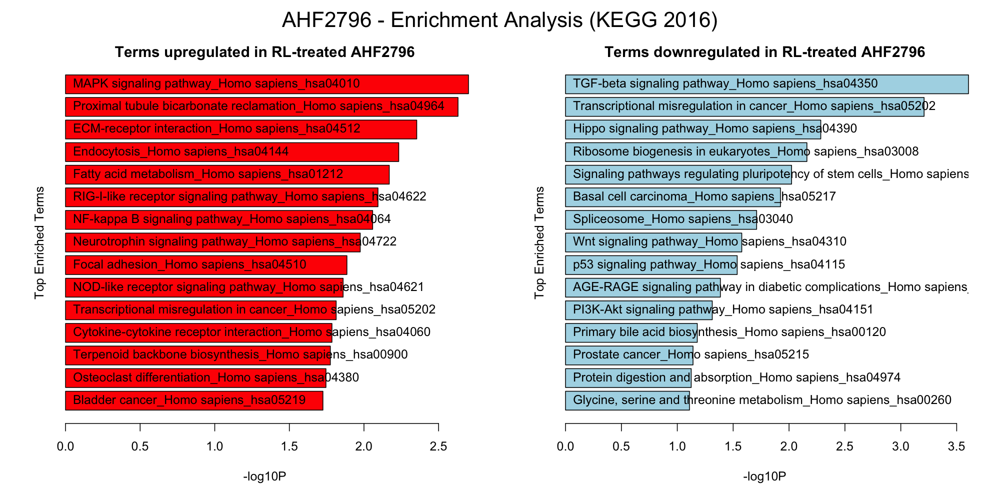

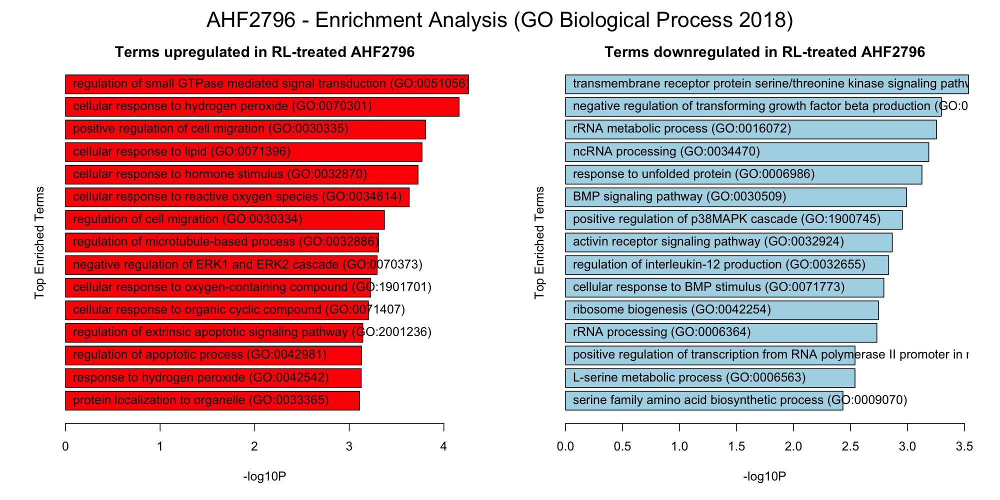

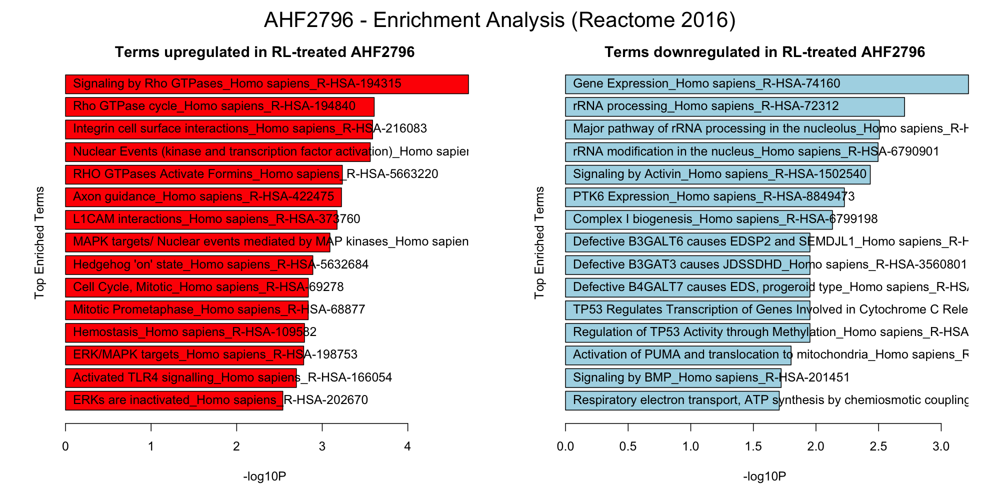

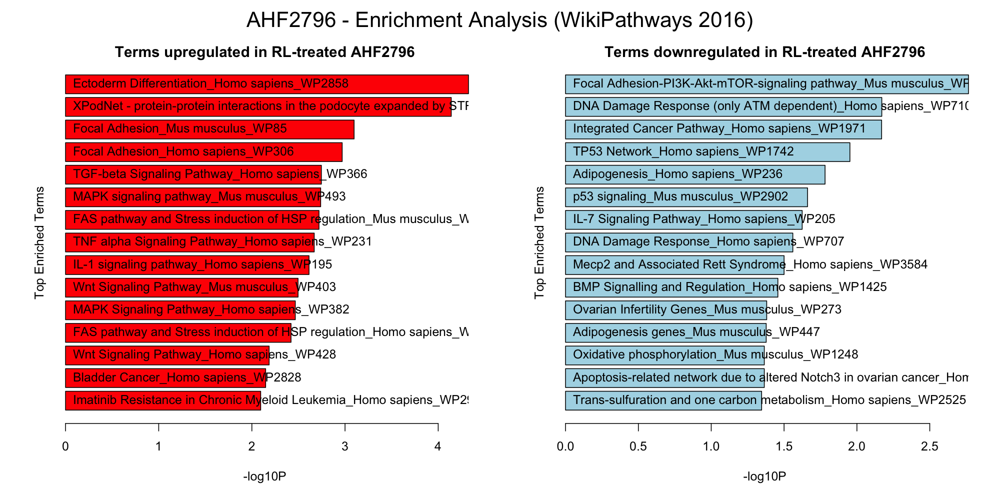

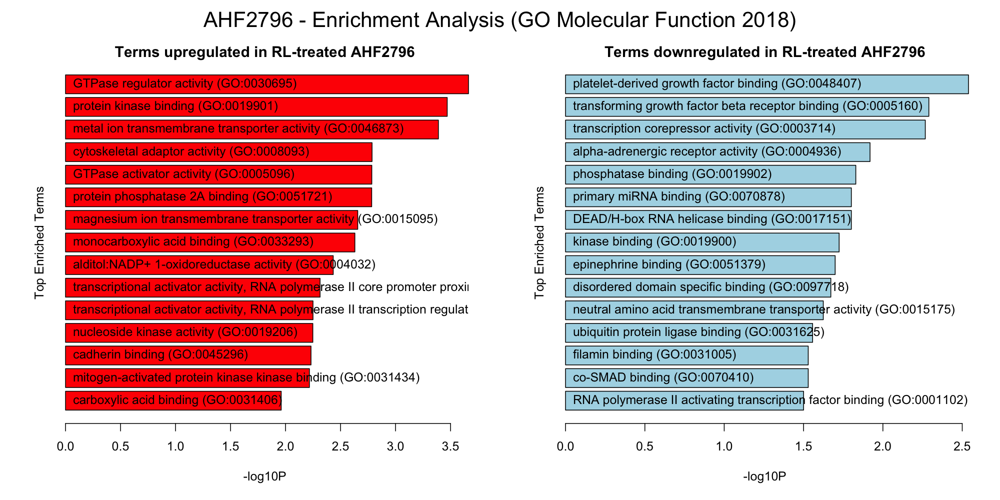

In [12]:
for cell_line, enrichment_dataframe in enrichment_results.items():
    enrichment_dataframe['log10FDR'] = -np.log10(enrichment_dataframe['FDR'])
    for library in enrichment_dataframe['gene_set_library'].unique():
        plot_dataframe = enrichment_dataframe[enrichment_dataframe['gene_set_library'] == library]
        library = library.replace('_', ' ')
        %R -i plot_dataframe,cell_line,library -h 1000 -w 2000 -r 150 layout(matrix(c(1,2), nrow = 1, ncol = 2, byrow = TRUE)); enrichment_barplot(plot_dataframe, 'up', cell_line); enrichment_barplot(plot_dataframe, 'down', cell_line); mtext(paste0(cell_line, ' - Enrichment Analysis (', library, ')'), side=3, outer=TRUE, line=-2, cex=1.7);
        

### Enrichr Links

In [50]:
data = {}
for jsonfile in glob.glob('./s4-enrichr.dir/*'):
    cell_line = os.path.basename(jsonfile).split('-')[0]
    if cell_line != 'kallisto':
        data[cell_line] = {}
        with open(jsonfile) as openfile:
            for key, value in json.load(openfile).items():
                url = 'https://amp.pharm.mssm.edu/Enrichr/enrich?dataset='+value['shortId']
                data[cell_line][key] = '<a href="{url}">{url}</a>'.format(**locals())

In [51]:
pd.set_option('max.colwidth', -1)

In [52]:
display(HTML(pd.DataFrame(data).T.to_html(escape=False)))

,down,up
AHF2796,https://amp.pharm.mssm.edu/Enrichr/enrich?dataset=96t42,https://amp.pharm.mssm.edu/Enrichr/enrich?dataset=96t40
AHF2617,https://amp.pharm.mssm.edu/Enrichr/enrich?dataset=96t3w,https://amp.pharm.mssm.edu/Enrichr/enrich?dataset=96t3s
AG13145,https://amp.pharm.mssm.edu/Enrichr/enrich?dataset=96t3r,https://amp.pharm.mssm.edu/Enrichr/enrich?dataset=96t3n
AHF2697,https://amp.pharm.mssm.edu/Enrichr/enrich?dataset=96t3z,https://amp.pharm.mssm.edu/Enrichr/enrich?dataset=96t3y
A375_melanoma,https://amp.pharm.mssm.edu/Enrichr/enrich?dataset=96t3m,https://amp.pharm.mssm.edu/Enrichr/enrich?dataset=96t3l
Keloid_MW3,https://amp.pharm.mssm.edu/Enrichr/enrich?dataset=96t44,https://amp.pharm.mssm.edu/Enrichr/enrich?dataset=96t43
